# Example Workflow: FOXA1 a3_wing2 Domain
- Author: Marc Zepeda
- Date: 240921
## Import Packages

In [1]:
import edms.gen.io as io
import edms.gen.tidy as t 
import edms.bio.pe as pe
import edms.dat.cosmic as co 
import edms.bio.clone as cl
import os
import re

## Prime Design Input: Creates PrimeDesign input file.
- target_name: name of target
- target_sequence: in-frame nucleotide sequence with (saturation mutagensis region)
- dir: name of the output directory 
- file: name of the output file
- Dependencies: pandas,io
- Reference: https://github.com/pinellolab/PrimeDesign/tree/master/PrimeDesign

In [2]:
pe.PrimeDesignInput(target_name='FOXA1_a3_wing2',
                    target_sequence='CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGTGGATCATGGACCTCTTCCCCTATTACCGGCAGAACCAGCAGCGC(TGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACTGCTTCGTCAAGGTGGCACGCTCCCCGGACAAGCCGGGCAAGGGCTCCTACTGGACGCTGCACCCGGACTCCGGCAACATGTTCGAGAACGGCTGCTACTTGCGCCGCCAGAAGCGCTTCAAGTGCGAG)AAGCAGCCGGGGGCCGGCGGCGGGGGCGGGAGCGGAAGCGGGGGCAGCGGCGCCAAGGGCGGCCCTGAGAGCCGCAAGGACCCCTCTGGC',
                    dir='.', # Needs to be the same directory for the next step
                    file='FOXA1_a3_wing2.csv')

## PrimeDesign: Run PrimeDesign using Docker 
- file (str): Input file (.txt or .csv) with sequences for PrimeDesign. Format: target_name,target_sequence (column names required)
- rtt_length_list (list): List of reverse transcription (RT) template lengths for the pegRNA extension. Example: 10 15 20
- nicking_distance_minimum (int): Minimum nicking distance for designing ngRNAs. (Default: 0 bp)
- nicking_distance_maximum (int): Maximum nicking distance for designing ngRNAs. (Default: 100 bp)
- filter_c1_extension (bool): Filter against pegRNA extensions that start with a C base. (Default: False)
- silent_mutation (bool): Introduce silent mutation into PAM assuming sequence is in-frame. Currently only available with SpCas9. (Default: False)
- genome_wide_design (bool): Whether this is a genome-wide pooled design. This option designs a set of pegRNAs per input without ranging PBS and RTT parameters.
- saturation_mutagenesis (str): Saturation mutagenesis design with prime editing (Options: 'aa', 'base').
- number_of_pegrnas (int): Maximum number of pegRNAs to design for each input sequence. The pegRNAs are ranked by 1) PAM disrupted > PAM intact then 2) distance to edit. (Default: 3)
- number_of_ngrnas (int): Maximum number of ngRNAs to design for each input sequence. The ngRNAs are ranked by 1) PE3b-seed > PE3b-nonseed > PE3 then 2) deviation from nicking_distance_pooled. (Default: 3)
- nicking_distance_pooled (int): The nicking distance between pegRNAs and ngRNAs for pooled designs. PE3b annotation is priority (PE3b seed -> PE3b non-seed), followed by nicking distance closest to this parameter. (Default: 75 bp)
- homology_downstream (int): For pooled designs (genome_wide or saturation_mutagenesis needs to be indicated), this parameter determines the RT extension length downstream of an edit for pegRNA designs. (Default: 10)
- pbs_length_pooled (int): The PBS length to design pegRNAs for pooled design applications. (Default: 14 nt)
- rtt_max_length_pooled (int): Maximum RTT length to design pegRNAs for pooled design applications. (Default: 50 nt)
- out_dir (str): Name of output directory. (Default: ./DATETIMESTAMP_PrimeDesign)
- Dependencies: os,numpy,https://github.com/pinellolab/PrimeDesign
### https://github.com/pinellolab/PrimeDesign
- Follow installation instructions: "Installation with Docker"
- This method uses PrimeDesign command line tool
### Docker
- Need to be running desktop app

In [24]:
pe.PrimeDesign(file='FOXA1_a3_wing2.csv',
               silent_mutation=True,
               saturation_mutagenesis='aa',
               number_of_pegrnas=3,
               number_of_ngrnas=1,
               pbs_length_pooled=13) # PBS length 13 pool
pe.PrimeDesign(file='FOXA1_a3_wing2.csv',
               silent_mutation=True,
               saturation_mutagenesis='aa',
               number_of_pegrnas=3,
               number_of_ngrnas=1,
               pbs_length_pooled=14) # PBS length 14 pool
pe.PrimeDesign(file='FOXA1_a3_wing2.csv',
               silent_mutation=True,
               saturation_mutagenesis='aa',
               number_of_pegrnas=3,
               number_of_ngrnas=1,
               pbs_length_pooled=15) # PBS length 15 pool

docker run -v ${PWD}/:/DATA -w /DATA pinellolab/primedesign primedesign_cli -f FOXA1_a3_wing2.csv -silent_mut -sat_mut aa -n_ngrnas 1 -pbs_pooled 13


2024-09-21 11:20:18,196 - INFO - Searching for pegRNAs and nicking gRNAs for target sequences ...
2024-09-21 11:20:20,452 - INFO - Completed pegRNA and ngRNA search for 1000 out of 1120 sites ...
2024-09-21 11:20:20,687 - INFO - Completed pegRNA and ngRNA search for 1120 out of 1120 sites ...
2024-09-21 11:20:20,687 - INFO - Writing pegRNA and ngRNA designs into output file 20240921_11.20.20_PrimeDesign.csv ...


docker run -v ${PWD}/:/DATA -w /DATA pinellolab/primedesign primedesign_cli -f FOXA1_a3_wing2.csv -silent_mut -sat_mut aa -n_ngrnas 1


2024-09-21 11:20:21,724 - INFO - Searching for pegRNAs and nicking gRNAs for target sequences ...
2024-09-21 11:20:24,357 - INFO - Completed pegRNA and ngRNA search for 1000 out of 1120 sites ...
2024-09-21 11:20:24,549 - INFO - Completed pegRNA and ngRNA search for 1120 out of 1120 sites ...
2024-09-21 11:20:24,550 - INFO - Writing pegRNA and ngRNA designs into output file 20240921_11.20.24_PrimeDesign.csv ...


docker run -v ${PWD}/:/DATA -w /DATA pinellolab/primedesign primedesign_cli -f FOXA1_a3_wing2.csv -silent_mut -sat_mut aa -n_ngrnas 1 -pbs_pooled 15


2024-09-21 11:20:25,467 - INFO - Searching for pegRNAs and nicking gRNAs for target sequences ...
2024-09-21 11:20:27,617 - INFO - Completed pegRNA and ngRNA search for 1000 out of 1120 sites ...
2024-09-21 11:20:27,808 - INFO - Completed pegRNA and ngRNA search for 1120 out of 1120 sites ...
2024-09-21 11:20:27,808 - INFO - Writing pegRNA and ngRNA designs into output file 20240921_11.20.27_PrimeDesign.csv ...


### Determine path to PrimeDesign outputs

In [30]:
io.print_relative_paths('.')

FOXA1_a3_wing2.csv
FOXA1_a3_wing2.ipynb
240921_11.20.21_PrimeDesign/PrimeDesign.log
240921_11.20.21_PrimeDesign/20240921_11.20.24_PrimeDesign.csv
240921_11.20.18_PrimeDesign/20240921_11.20.20_PrimeDesign.csv
240921_11.20.18_PrimeDesign/PrimeDesign.log
240921_11.20.25_PrimeDesign/PrimeDesign.log
240921_11.20.25_PrimeDesign/20240921_11.20.27_PrimeDesign.csv
240921_10.21.55_PrimeDesign/PrimeDesign.log
240921_10.21.55_PrimeDesign/20240921_10.21.57_PrimeDesign.csv


## PrimeDesignOutput: Splits peg/ngRNAs from PrimeDesign output & finishes annotations
- pt: path to primeDesign output
- aa_index: 1st amino acid in target sequence index (Optional, Default: start codon = 1)
- scaffold_sequence: sgRNA scaffold sequence (Optional, Default: SpCas9)
- Dependencies: io,numpy

In [3]:
pegRNAs = dict()
ngRNAs = dict()

pegRNAs['pegRNAs_pbs13'],ngRNAs['ngRNAs_pbs13'] = pe.PrimeDesignOutput(pt='240921_11.20.18_PrimeDesign/20240921_11.20.20_PrimeDesign.csv',
                                                                                        aa_index=214)
pegRNAs['pegRNAs_pbs14'],ngRNAs['ngRNAs_pbs14'] = pe.PrimeDesignOutput(pt='240921_11.20.21_PrimeDesign/20240921_11.20.24_PrimeDesign.csv',
                                                                                        aa_index=214)
pegRNAs['pegRNAs_pbs15'],ngRNAs['ngRNAs_pbs15'] = pe.PrimeDesignOutput(pt='240921_11.20.25_PrimeDesign/20240921_11.20.27_PrimeDesign.csv',
                                                                                        aa_index=214)

os.mkdir('../PrimeDesignOutput')
io.save_dir(dir='../PrimeDesignOutput/pegRNAs',
            file_suffix='.csv',
            dc=pegRNAs)
io.save_dir(dir='../PrimeDesignOutput/ngRNAs',
            file_suffix='.csv',
            dc=ngRNAs)

In [33]:
pegRNAs['pegRNAs_pbs13'].head()

,pegRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,RTT_sequence,PBS_sequence,Target_name,Target_sequence,...,Extension_sequence,Annotation,pegRNA-to-edit_distance,Nick_index,ngRNA-to-pegRNA_distance,PBS_length,PBS_GC_content,RTT_length,RTT_GC_content,First_extension_nucleotide
0,1,pegRNA,+,W214G,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGgccGCG,CTGCTGGTTCTGC,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,TGGAGTTCTGgccGCGCTGCTGGTTCTGC,PAM_disrupted,6.0,87,NaN,13.0,0.62,16.0,0.69,T
1,2,pegRNA,-,W214G,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACagcATCC,GCCACTCGCTGTC,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCggcCAGAACagcATCCGCCACTCGCTGTC,PAM_disrupted_silent_mutation,16.0,106,NaN,13.0,0.69,26.0,0.69,C
2,3,pegRNA,-,W214G,CATTGAAGGACAGCGAGTGG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACTCCattCGCCA,CTCGCTGTCCTTC,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCggcCAGAACTCCattCGCCACTCGCTGTCCTTC,PAM_disrupted_silent_mutation,20.0,110,NaN,13.0,0.62,30.0,0.67,C
3,4,pegRNA,+,W214E,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGctcGCG,CTGCTGGTTCTGC,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,TGGAGTTCTGctcGCGCTGCTGGTTCTGC,PAM_disrupted,6.0,87,NaN,13.0,0.62,16.0,0.62,T
4,5,pegRNA,-,W214E,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCgagCAGAACagcATCC,GCCACTCGCTGTC,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCgagCAGAACagcATCCGCCACTCGCTGTC,PAM_disrupted_silent_mutation,16.0,106,NaN,13.0,0.69,26.0,0.65,C


In [34]:
ngRNAs['ngRNAs_pbs13'].head()

,pegRNA_number,ngRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,Target_name,Target_sequence,Spacer_GC_content,...,Extension_sequence,Annotation,pegRNA-to-edit_distance,Nick_index,ngRNA-to-pegRNA_distance,PBS_length,PBS_GC_content,RTT_length,RTT_GC_content,First_extension_nucleotide
0,1,0,ngRNA,-,W214G,TGGAGTTCTGgccGCGCTGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,0.70,...,NaN,PE3b-seed,NaN,86,-1.0,NaN,NaN,NaN,NaN,NaN
1,2,1,ngRNA,+,W214G,AGCCGGGCAAGGGCTCCTAC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,0.70,...,NaN,PE3,NaN,177,71.0,NaN,NaN,NaN,NaN,NaN
2,3,2,ngRNA,+,W214G,CTCCTACTGGACGCTGCACC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,0.65,...,NaN,PE3,NaN,190,80.0,NaN,NaN,NaN,NaN,NaN
3,4,3,ngRNA,-,W214E,TGGAGTTCTGctcGCGCTGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,0.65,...,NaN,PE3b-seed,NaN,86,-1.0,NaN,NaN,NaN,NaN,NaN
4,5,4,ngRNA,+,W214E,AGCCGGGCAAGGGCTCCTAC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,0.70,...,NaN,PE3,NaN,177,71.0,NaN,NaN,NaN,NaN,NaN


## shared_sequences: Reduce PE library into shared spacers and PBS sequences.
- pegRNAs: pegRNAs DataFrame
- hist_plot: display histogram of reduced PE library (Optional, False)
- hist_dir: directory to save histogram
- hist_file: file name to save histogram
- Dependencies: pandas,plot

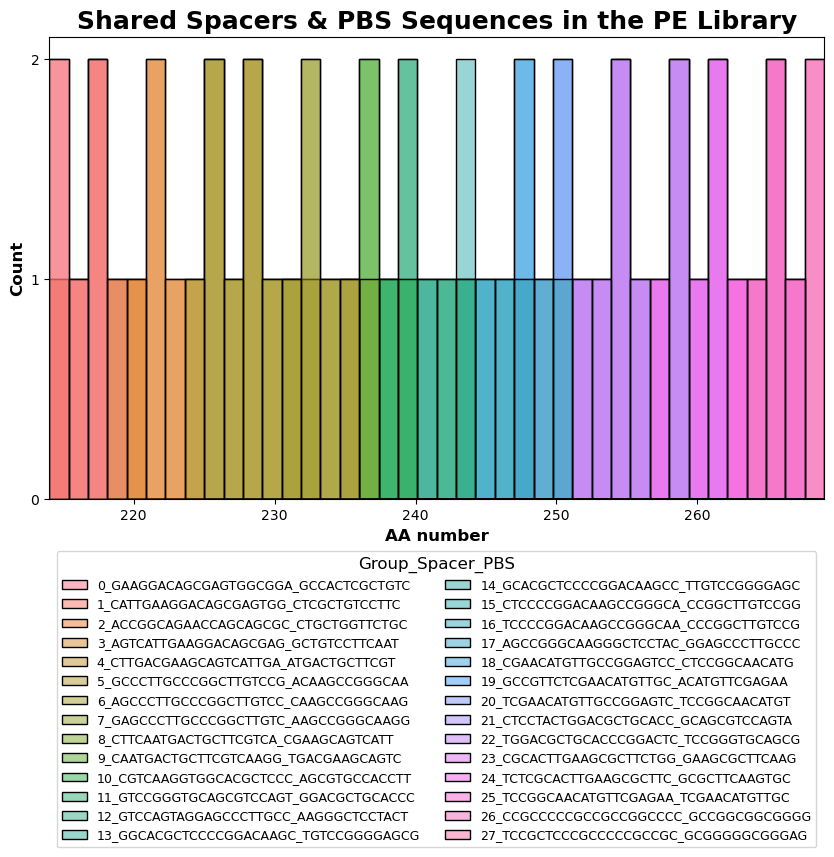

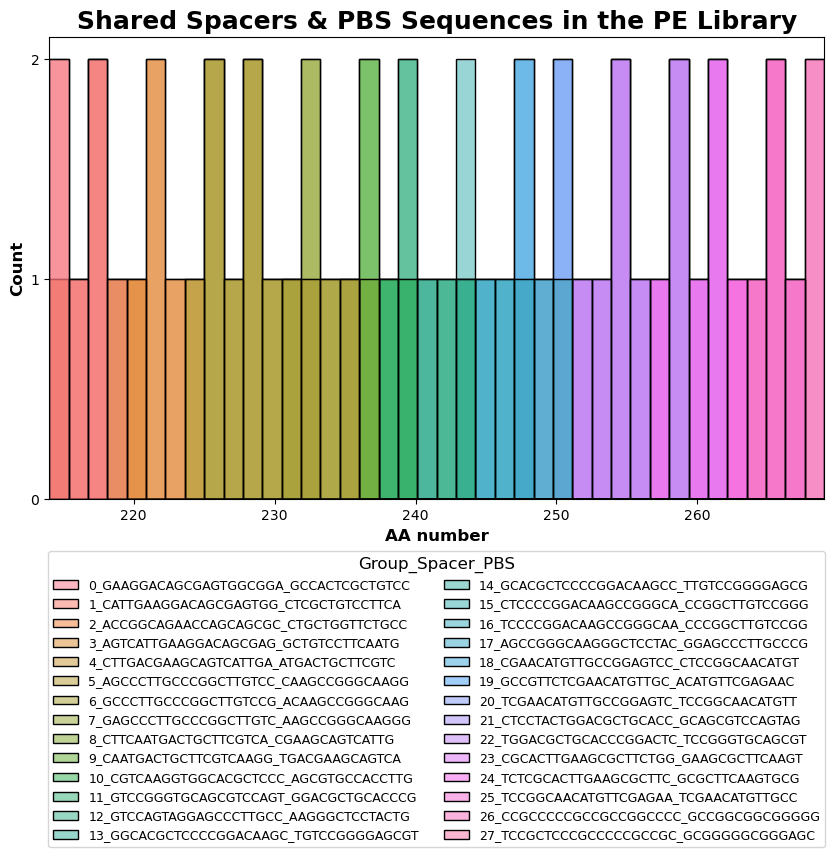

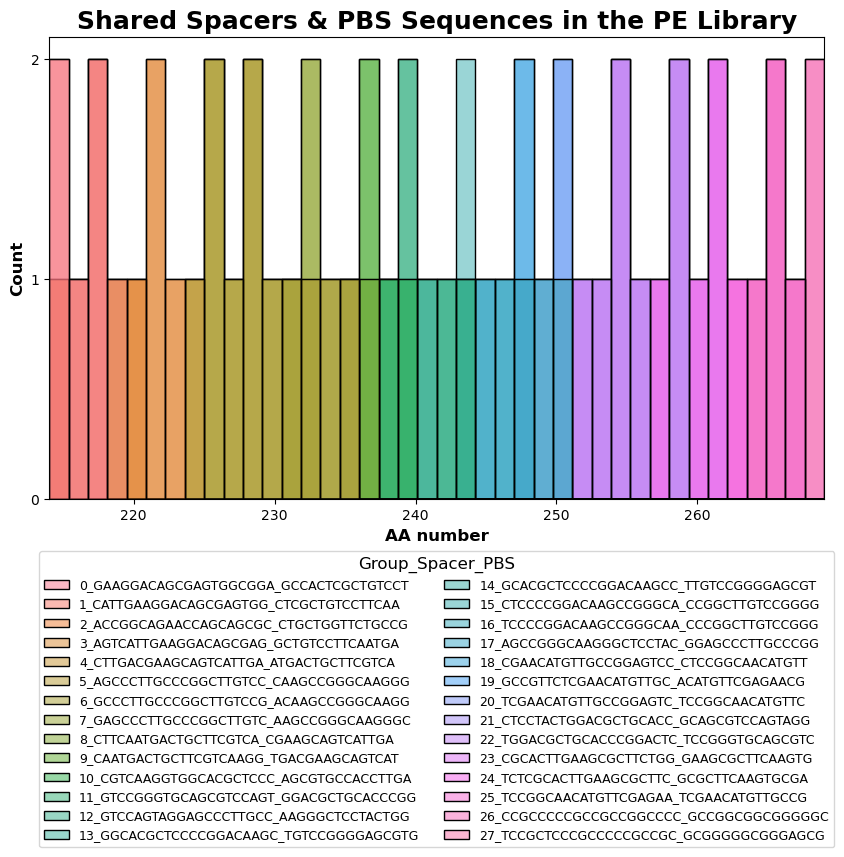

In [4]:
pegRNAs_shared = dict()
for key,pegRNAs_pbs in pegRNAs.items():
    pegRNAs_shared[key] = pe.shared_sequences(pegRNAs=pegRNAs_pbs, 
                                              hist_dir='../shared_sequences',
                                              hist_file=f'{key}.png')
io.save_dir(dir='../shared_sequences',
            file_suffix='.csv',
            dc=pegRNAs_shared)


In [40]:
pegRNAs_shared['pegRNAs_pbs13'].head()

,pegRNA_numbers,Strand,Edits,Spacer_sequence,PBS_sequence,AA_numbers,AA_numbers_min,AA_numbers_max,AA_numbers_continuous
0,"[2, 5, 8, 11, 14, 17, 20, 23, 26, 29, 32, 35, ...",-,"[W214G, W214E, W214D, W214V, W214A, W214R, W21...",GAAGGACAGCGAGTGGCGGA,GCCACTCGCTGTC,"[214, 215, 216, 217, 218]",214,218,True
1,"[3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, ...",-,"[W214G, W214E, W214D, W214V, W214A, W214R, W21...",CATTGAAGGACAGCGAGTGG,CTCGCTGTCCTTC,"[214, 215, 216, 217, 218, 219]",214,219,True
2,"[1, 4, 7, 10, 13, 16, 19, 22, 25, 28, 31, 34, ...",+,"[W214G, W214E, W214D, W214V, W214A, W214R, W21...",ACCGGCAGAACCAGCAGCGC,CTGCTGGTTCTGC,"[214, 220, 221, 222, 223]",214,223,False
3,"[63, 66, 69, 72, 75, 78, 81, 84, 87, 90, 93, 9...",-,"[Q215G, Q215E, Q215D, Q215V, Q215A, Q215R, Q21...",AGTCATTGAAGGACAGCGAG,GCTGTCCTTCAAT,"[215, 216, 217, 218, 219, 220]",215,220,True
4,"[303, 306, 309, 312, 315, 318, 321, 324, 327, ...",-,"[R219G, R219E, R219D, R219V, R219A, R219S, R21...",CTTGACGAAGCAGTCATTGA,ATGACTGCTTCGT,"[219, 220, 221, 222, 223, 224]",219,224,True


### Check spacer and pbs match between pbs length shared sequences libraries

In [3]:
pe.print_shared_sequences(pegRNAs_shared)

	pegRNAs_pbs13_spacer	pegRNAs_pbs13_PBS	pegRNAs_pbs14_spacer	pegRNAs_pbs14_PBS	pegRNAs_pbs15_spacer	pegRNAs_pbs15_PBS
0:	GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTC		GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTCC		GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTCCT		
1:	CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTC		CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTCA		CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTCAA		
2:	ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGC		ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGCC		ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGCCG		
3:	AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAAT		AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAATG		AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAATGA		
4:	CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGT		CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGTC		CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGTCA		
5:	AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCAAG		AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCAAGG		AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCAAGGG		
6:	GCCCTTGCCCGGCTTGTCCG	ACAAGCCGGGCAA		GCCCTTGCCCGGCTTGTCCG	ACAAGCCGGGCAAG		GCCCTTGCCCGGCTTGTCCG	ACAAGCCGGGCAAGG		
7:	GAGCCCTTGCCCGGCTTGTC	AAGCCGGGCAAGG		GAGCCCTTGCCCGGCTTGTC	AAGCCGGGCAAGGG		G

## priority_muts: Returns the shared sequences library dataframe with priority mutations
- pegRNAs: pegRNAs library dataframe
- pegRNAs_shared: pegRNAs shared sequences library dataframe
- pt: path to COSMIC csv file
- Dependencies: pandas,ast,io,prevalence(),mutations()
### How obtain COSMIC csv file
1. Go to https://cancer.sanger.ac.uk/cosmic
2. Search "FOXA1" & click on FOXA1 Gene hyperlink.
    - https://cancer.sanger.ac.uk/cosmic/search?q=FOXA1
    - https://cancer.sanger.ac.uk/cosmic/gene/analysis?ln=FOXA1
3. Go to "Variants" header and click "Export: CSV"
    - https://cancer.sanger.ac.uk/cosmic/gene/mutations?all_data=&coords=AA%3AAA&dr=&end=473&gd=&id=336391&ln=FOXA1&seqlen=473&src=gene&start=1&sEcho=1&iColumns=6&sColumns=&iDisplayStart=0&iDisplayLength=10&mDataProp_0=0&sSearch_0=&bRegex_0=false&bSearchable_0=true&bSortable_0=true&mDataProp_1=1&sSearch_1=&bRegex_1=false&bSearchable_1=true&bSortable_1=true&mDataProp_2=2&sSearch_2=&bRegex_2=false&bSearchable_2=true&bSortable_2=true&mDataProp_3=3&sSearch_3=&bRegex_3=false&bSearchable_3=true&bSortable_3=true&mDataProp_4=4&sSearch_4=&bRegex_4=false&bSearchable_4=true&bSortable_4=true&mDataProp_5=5&sSearch_5=&bRegex_5=false&bSearchable_5=true&bSortable_5=true&sSearch=&bRegex=false&iSortCol_0=0&sSortDir_0=asc&iSortingCols=1&export=csv
4. Move file to "COSMIC" folder 

In [4]:
pegRNAs_shared_muts = dict()
for key,pegRNAs_shared_pbs in pegRNAs_shared.items():
    pegRNAs_shared_muts[key]=co.priority_muts(pegRNAs=pegRNAs[key],
                                         pegRNAs_shared=pegRNAs_shared_pbs,
                                         pt='../COSMIC/Gene_mutationsSat Sep 21 13_04_33 2024.csv')
io.save_dir(dir='../shared_sequences_muts',
            file_suffix='.csv',
            dc=pegRNAs_shared_muts)

### Check spacer, pbs, & mutant match between pbs length shared sequences libraries

In [5]:
pe.print_shared_sequences_mutant(pegRNAs_shared_muts)

	pegRNAs_pbs13_spacer	pegRNAs_pbs13_PBS	pegRNAs_pbs13_mutant	pegRNAs_pbs14_spacer	pegRNAs_pbs14_PBS	pegRNAs_pbs14_mutant	pegRNAs_pbs15_spacer	pegRNAs_pbs15_PBS	pegRNAs_pbs15_mutant
0:	GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTC		I218T			GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTCC		I218T			GAAGGACAGCGAGTGGCGGA	GCCACTCGCTGTCCT		I218T			
1:	CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTC		R219S			CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTCA		R219S			CATTGAAGGACAGCGAGTGG	CTCGCTGTCCTTCAA		R219S			
2:	ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGC		H220Q			ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGCC		H220Q			ACCGGCAGAACCAGCAGCGC	CTGCTGGTTCTGCCG		H220Q			
3:	AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAAT		R219C			AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAATG		R219C			AGTCATTGAAGGACAGCGAG	GCTGTCCTTCAATGA		R219C			
4:	CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGT		F224L			CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGTC		F224L			CTTGACGAAGCAGTCATTGA	ATGACTGCTTCGTCA		F224L			
5:	AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCAAG		S234C			AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCAAGG		S234C			AGCCCTTGCCCGGCTTGTCC	CAAGCCGGGCA

## priority_edits: Returns a dataframe with the most clinically-relevant prime edits to prioritize from the shared sequences library
- pegRNAs: pegRNAs library dataframe
- pegRNAs_shared: pegRNAs shared sequences library dataframe
- pt: path to COSMIC csv file
- Dependencies: pandas,ast,io,prevalence(),mutations()
### How obtain COSMIC csv file
1. Go to https://cancer.sanger.ac.uk/cosmic
2. Search "FOXA1" & click on FOXA1 Gene hyperlink.
    - https://cancer.sanger.ac.uk/cosmic/search?q=FOXA1
    - https://cancer.sanger.ac.uk/cosmic/gene/analysis?ln=FOXA1
3. Go to "Variants" header and click "Export: CSV"
    - https://cancer.sanger.ac.uk/cosmic/gene/mutations?all_data=&coords=AA%3AAA&dr=&end=473&gd=&id=336391&ln=FOXA1&seqlen=473&src=gene&start=1&sEcho=1&iColumns=6&sColumns=&iDisplayStart=0&iDisplayLength=10&mDataProp_0=0&sSearch_0=&bRegex_0=false&bSearchable_0=true&bSortable_0=true&mDataProp_1=1&sSearch_1=&bRegex_1=false&bSearchable_1=true&bSortable_1=true&mDataProp_2=2&sSearch_2=&bRegex_2=false&bSearchable_2=true&bSortable_2=true&mDataProp_3=3&sSearch_3=&bRegex_3=false&bSearchable_3=true&bSortable_3=true&mDataProp_4=4&sSearch_4=&bRegex_4=false&bSearchable_4=true&bSortable_4=true&mDataProp_5=5&sSearch_5=&bRegex_5=false&bSearchable_5=true&bSortable_5=true&sSearch=&bRegex=false&iSortCol_0=0&sSortDir_0=asc&iSortingCols=1&export=csv
4. Move file to "COSMIC" folder 

In [6]:
pegRNAs_priority = dict()
for key,pegRNAs_shared_pbs in pegRNAs_shared_muts.items():
    pegRNAs_priority[key]=co.priority_edits(pegRNAs=pegRNAs[key],
                                            pegRNAs_shared=pegRNAs_shared_pbs,
                                            pt='../COSMIC/Gene_mutationsSat Sep 21 13_04_33 2024.csv')
io.save_dir(dir='../pegRNAs_priority',
            file_suffix='.csv',
            dc=pegRNAs_priority)

In [7]:
pegRNAs_priority['pegRNAs_pbs13'].head()

,pegRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,RTT_sequence,PBS_sequence,Target_name,Target_sequence,...,Annotation,pegRNA-to-edit_distance,Nick_index,ngRNA-to-pegRNA_distance,PBS_length,PBS_GC_content,RTT_length,RTT_GC_content,First_extension_nucleotide,COSMIC_count
0,271,pegRNA,-,I218T,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GCAGAACagcaccC,GCCACTCGCTGTC,FOXA1_a3_wing2_5_ItoT,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,PAM_disrupted_silent_mutation,4.0,106,NaN,13.0,0.69,14.0,0.64,G,1
1,316,pegRNA,-,R219S,CATTGAAGGACAGCGAGTGG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GAACTCCATCagcCA,CTCGCTGTCCTTC,FOXA1_a3_wing2_6_RtoS,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,PAM_disrupted,5.0,110,NaN,13.0,0.62,15.0,0.53,G,1
2,417,pegRNA,+,H220Q,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,AGGACAGCGActgGCGGATGGAGTTCTGCCAGCG,CTGCTGGTTCTGC,FOXA1_a3_wing2_7_HtoQ,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,PAM_intact,24.0,87,NaN,13.0,0.62,34.0,0.65,A,1
3,341,pegRNA,-,R219C,AGTCATTGAAGGACAGCGAG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GAACTCCATCtgtCACTC,GCTGTCCTTCAAT,FOXA1_a3_wing2_6_RtoC,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,PAM_disrupted_silent_mutation,8.0,113,NaN,13.0,0.46,18.0,0.50,G,1
4,589,pegRNA,-,F224L,CTTGACGAAGCAGTCATTGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CTCGCTGagcctgA,ATGACTGCTTCGT,FOXA1_a3_wing2_11_FtoL,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,PAM_disrupted_silent_mutation,4.0,124,NaN,13.0,0.46,14.0,0.64,C,2


## epegRNA_linkers: Generate epegRNA linkers between PBS and 3' hairpin motif & finish annotations
- pegRNAs: pegRNAs DataFrame
- epegRNA_motif_sequence: epegRNA motif sequence (Optional, Default: tevopreQ1)
- checkpoint_dir: Checkpoint directory (Optional)
- checkpoint_file: Checkpoint file name (Optional)
- checkpoint_pt: Previous checkpoint path (Optional)
- Dependencies: pandas,pegLIT,io
### Takes ~1-2 min per epegRNA
- Future Goal: Run as parallelized job on cluster GPUs.

In [8]:
os.mkdir('../epegRNAs_priority')
epegRNAs_priority = dict()
for key,pegRNAs_priority_pbs in pegRNAs_priority.items():
    epegRNAs_priority[key] = pe.epegRNA_linkers(pegRNAs=pegRNAs_priority_pbs,
                                                checkpoint_dir='../epegRNAs_priority/checkpoints',
                                                checkpoint_file=f'{key}.csv')
io.save_dir(dir='../epegRNAs_priority',
            file_suffix='.csv',
            dc=epegRNAs_priority)

Status: 0 out of 28
Status: 1 out of 28
Status: 2 out of 28
Status: 3 out of 28
Status: 4 out of 28
Status: 5 out of 28
Status: 6 out of 28
Status: 7 out of 28
Status: 8 out of 28
Status: 9 out of 28
Status: 10 out of 28
Status: 11 out of 28
Status: 12 out of 28
Status: 13 out of 28
Status: 14 out of 28
Status: 15 out of 28
Status: 16 out of 28
Status: 17 out of 28
Status: 18 out of 28
Status: 19 out of 28
Status: 20 out of 28
Status: 21 out of 28
Status: 22 out of 28
Status: 23 out of 28
Status: 24 out of 28
Status: 25 out of 28
Status: 26 out of 28
Status: 27 out of 28
Status: 0 out of 28
Status: 1 out of 28
Status: 2 out of 28
Status: 3 out of 28
Status: 4 out of 28
Status: 5 out of 28
Status: 6 out of 28
Status: 7 out of 28
Status: 8 out of 28
Status: 9 out of 28
Status: 10 out of 28
Status: 11 out of 28
Status: 12 out of 28
Status: 13 out of 28
Status: 14 out of 28
Status: 15 out of 28
Status: 16 out of 28
Status: 17 out of 28
Status: 18 out of 28
Status: 19 out of 28
Status: 20 o

## Design subpools PCR1 Barcode & Homology Arms
The structure of the final oligonucleotide for synthesis should be as follows:
- 5'-Forward Barcode -- 5' Homology Arm -- Spacer -- Scaffold -- Extension (RTT + PBS + linker) -- 3' Homology Arm -- Reverse Barcode-3'
- 5' Homology Arm = 5'-GTGGAAAGGACGAAACACC-3'
- 3' Homology Arm = 5'-CGCGGTTCTATCTAGTTACGCGTTAAACC-3'
- pMUZ86.5: epegRNAs; pU6-tevopreq1-GG-acceptor; Prime editing in mammalian cells
    - HEK293T transfection
    - Gesicle HEK293T transfection for VLP production
- pMUZ86.15: LentiV2-hU6-evopreQ1-puro; pegRNA cloning
    - HEK293T transfection for lentivirus production
- pMUZ86.17: LentiV2-hU6-evopreQ1-blast; pegRNA cloning
    - HEK293T transfection for lentivirus production


In [12]:
epegRNAs = t.join(epegRNAs_priority)

befores = []
nums = []
afters = []
for edit in epegRNAs['Edit']:
    num = int(re.findall(r'-?\d+',edit)[0])
    nums.append(num)
    befores.append(edit.split(str(num))[0])
    afters.append(edit.split(str(num))[1])
epegRNAs['AA_position']=nums
epegRNAs['AA_before']=befores
epegRNAs['AA_after']=afters

epegRNAs = epegRNAs.sort_values(by=['PBS_length','AA_position']).reset_index(drop=True)
epegRNAs = cl.pe_twist_oligos(df=epegRNAs)
epegRNAs['ID']=[f"epegRNA{i}" for i in range(len(epegRNAs['pegRNA_number']))]

io.save(dir='../epegRNAs_twist_order',
        file='epegRNAs.csv',
        obj=epegRNAs)

/Users/marczepeda/git/git_edms/edms/bio/clone.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pcr1_barcodes['PBS_length']=pbs_lengths_ls
/Users/marczepeda/git/git_edms/edms/bio/clone.py:377: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pcr1_barcodes['Strand']=strands_ls


In [13]:
epegRNAs.head()

,pegRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,RTT_sequence,PBS_sequence,Linker_sequence,Motif_sequence,...,Forward PCR1 Primer IDT Tm,Reverse PCR1 Primer IDT Tm,Forward PCR1 Primer IDT Th,Reverse PCR1 Primer IDT Th,Forward PCR1 Primer ID,Reverse PCR1 Primer ID,First_spacer_nucleotide,Twist_oligo,twist_oligo_length,ID
0,271,pegRNA,-,I218T,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GCAGAACagcaccC,GCCACTCGCTGTC,ATAAGAAC,CGCGGTTCTATCTAGTTACGCGTTAAACCAACTAGAA,...,63.4,62.7,45.3,45.3,fpMUZ141.4,rpMUZ141.4,G,GAGGTCTTTCATGCGTGGAAAGGACGAAACACCGAAGGACAGCGAG...,235,epegRNA0
1,316,pegRNA,-,R219S,CATTGAAGGACAGCGAGTGG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GAACTCCATCagcCA,CTCGCTGTCCTTC,CCTTATTC,CGCGGTTCTATCTAGTTACGCGTTAAACCAACTAGAA,...,63.4,62.7,45.3,45.3,fpMUZ141.4,rpMUZ141.4,C,GAGGTCTTTCATGCGTGGAAAGGACGAAACACCGCATTGAAGGACA...,237,epegRNA1
2,341,pegRNA,-,R219C,AGTCATTGAAGGACAGCGAG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,GAACTCCATCtgtCACTC,GCTGTCCTTCAAT,AAATCCGT,CGCGGTTCTATCTAGTTACGCGTTAAACCAACTAGAA,...,63.4,62.7,45.3,45.3,fpMUZ141.4,rpMUZ141.4,A,GAGGTCTTTCATGCGTGGAAAGGACGAAACACCGAGTCATTGAAGG...,240,epegRNA2
3,589,pegRNA,-,F224L,CTTGACGAAGCAGTCATTGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CTCGCTGagcctgA,ATGACTGCTTCGT,ATCTCCTT,CGCGGTTCTATCTAGTTACGCGTTAAACCAACTAGAA,...,63.4,62.7,45.3,45.3,fpMUZ141.4,rpMUZ141.4,C,GAGGTCTTTCATGCGTGGAAAGGACGAAACACCGCTTGACGAAGCA...,236,epegRNA3
4,870,pegRNA,-,V229I,GAGCCCTTGCCCGGCTTGTC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGACTGCTTCatcAAGGTGGCACGCTCCCCGGAC,AAGCCGGGCAAGG,AAATAAAT,CGCGGTTCTATCTAGTTACGCGTTAAACCAACTAGAA,...,63.4,62.7,45.3,45.3,fpMUZ141.4,rpMUZ141.4,G,GAGGTCTTTCATGCGTGGAAAGGACGAAACACCGAGCCCTTGCCCG...,255,epegRNA4


# Work in Progress

## RTT_designer: Design all possible RTT for given spacer & PBS (WT, single insertions, & single deletions)
- pegRNAs: pegRNAs DataFrame
- file (str): Input file (.txt or .csv) with sequences for PrimeDesign. Format: target_name,target_sequence (column names required)
- aa_index: 1st amino acid in target sequence index (Optional, Default: start codon = 1)
- RTT_length: Reverse transcriptase template length (bp)
- Dependencies: io,Bio.Seq.Seq,shared_sequences(),get_codons(),get_codon_frames(),is_sublist_in_order(),aa_dna_codon_table

In [41]:
pegRNAs_all = dict()
for key,pegRNA_pbs in pegRNAs.items():
    pegRNAs_all[key] = pe.RTT_designer(pegRNAs=pegRNAs_pbs,
                                       file='FOXA1_a3_wing2.csv',
                                       aa_index=214)
    io.save(dir='../RTT_designer',
        file=f'{key}.csv',
        obj=pegRNAs_shared[key])

FWD Ref: CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGTGGATCATGGACCTCTTCCCCTATTACCGGCAGAACCAGCAGCGCTGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACTGCTTCGTCAAGGTGGCACGCTCCCCGGACAAGCCGGGCAAGGGCTCCTACTGGACGCTGCACCCGGACTCCGGCAACATGTTCGAGAACGGCTGCTACTTGCGCCGCCAGAAGCGCTTCAAGTGCGAGAAGCAGCCGGGGGCCGGCGGCGGGGGCGGGAGCGGAAGCGGGGGCAGCGGCGCCAAGGGCGGCCCTGAGAGCCGCAAGGACCCCTCTGGC
REV Ref: GCCAGAGGGGTCCTTGCGGCTCTCAGGGCCGCCCTTGGCGCCGCTGCCCCCGCTTCCGCTCCCGCCCCCGCCGCCGGCCCCCGGCTGCTTCTCGCACTTGAAGCGCTTCTGGCGGCGCAAGTAGCAGCCGTTCTCGAACATGTTGCCGGAGTCCGGGTGCAGCGTCCAGTAGGAGCCCTTGCCCGGCTTGTCCGGGGAGCGTGCCACCTTGACGAAGCAGTCATTGAAGGACAGCGAGTGGCGGATGGAGTTCTGCCAGCGCTGCTGGTTCTGCCGGTAATAGGGGAAGAGGTCCATGATCCACTGGTAGATCTCGCTCAGCGTGAGCATCTTGCTGGGCGCCTGCTG
Nucleotides: TGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACTGCTTCGTCAAGGTGGCACGCTCCCCGGACAAGCCGGGCAAGGGCTCCTACTGGACGCTGCACCCGGACTCCGGCAACATGTTCGAGAACGGCTGCTACTTGCGCCGCCAGAAGCGCTTCAAGTGCGAG
Amino Acids: WQNSIRHSLSFNDCFVKVARSPDKPGKGSYWTLHPDSGNMFENGCYLRRQKRFKCE

Used extended codons
Strand: -


In [42]:
pegRNAs_all['pegRNAs_pbs13'].head()

,pegRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,RTT_sequence,PBS_sequence,Target_name,Target_sequence,...,Extension_sequence,Annotation,pegRNA-to-edit_distance,Nick_index,ngRNA-to-pegRNA_distance,PBS_length,PBS_GC_content,RTT_length,RTT_GC_content,First_extension_nucleotide
0,1,pegRNA,+,W214G,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGgccGCG,CTGCTGGTTCTGCCG,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,TGGAGTTCTGgccGCGCTGCTGGTTCTGCCG,PAM_disrupted,6.0,87,NaN,15.0,0.67,16.0,0.69,T
1,2,pegRNA,-,W214G,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACagcATCC,GCCACTCGCTGTCCT,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCggcCAGAACagcATCCGCCACTCGCTGTCCT,PAM_disrupted_silent_mutation,16.0,106,NaN,15.0,0.67,26.0,0.69,C
2,3,pegRNA,-,W214G,CATTGAAGGACAGCGAGTGG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACTCCattCGCCA,CTCGCTGTCCTTCAA,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCggcCAGAACTCCattCGCCACTCGCTGTCCTTCAA,PAM_disrupted_silent_mutation,20.0,110,NaN,15.0,0.53,30.0,0.67,C
3,4,pegRNA,+,W214E,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGctcGCG,CTGCTGGTTCTGCCG,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,TGGAGTTCTGctcGCGCTGCTGGTTCTGCCG,PAM_disrupted,6.0,87,NaN,15.0,0.67,16.0,0.62,T
4,5,pegRNA,-,W214E,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCgagCAGAACagcATCC,GCCACTCGCTGTCCT,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,CCAGCAGCGCgagCAGAACagcATCCGCCACTCGCTGTCCT,PAM_disrupted_silent_mutation,16.0,106,NaN,15.0,0.67,26.0,0.65,C


## pegRNAs_tester: Confirm that pegRNAs should create the predicted edit
- pegRNAs: pegRNAs DataFrame
- file (str): Input file (.txt or .csv) with sequences for PrimeDesign. Format: target_name,target_sequence (column names required)
- aa_index: 1st amino acid in target sequence index (Optional, Default: start codon = 1)
- Dependencies: Bio.Seq.Seq,numpy,pandas,is_sublist_in_order(),get_codons(),get_codon_frames(),compare_RTTs()
### Common errors for calling edits that should be ignored...
- deletions:
    1. single deletion of repeated AA results in wrong AA #
    2. AA deletion outside of target sequence boundary results in wrong AA #
- insertions:
    1. single insertion of repeated AA results in wrong AA #
    2. inserted AA matches the next (+ strand) or previous (- strand) AA, so compare_RTTs() shifts mutation by 1 AA
    3. single insertion of final AA in RTT, which matches next AA and returns wildtype sequence

In [45]:
pegRNAs_all_test = dict()
for key,pegRNA_pbs in pegRNAs_all.items():
    pegRNAs_all_test[key] = pe.pegRNAs_tester(pegRNAs=pegRNA_pbs,
                                         file='FOXA1_a3_wing2.csv',
                                         aa_index=214)
    io.save(dir='../pegRNAs_tester',
            file=f'{key}.csv',
            obj=pegRNAs_all_test)

FWD Ref: CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGTGGATCATGGACCTCTTCCCCTATTACCGGCAGAACCAGCAGCGCTGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACTGCTTCGTCAAGGTGGCACGCTCCCCGGACAAGCCGGGCAAGGGCTCCTACTGGACGCTGCACCCGGACTCCGGCAACATGTTCGAGAACGGCTGCTACTTGCGCCGCCAGAAGCGCTTCAAGTGCGAGAAGCAGCCGGGGGCCGGCGGCGGGGGCGGGAGCGGAAGCGGGGGCAGCGGCGCCAAGGGCGGCCCTGAGAGCCGCAAGGACCCCTCTGGC
REV Ref: GCCAGAGGGGTCCTTGCGGCTCTCAGGGCCGCCCTTGGCGCCGCTGCCCCCGCTTCCGCTCCCGCCCCCGCCGCCGGCCCCCGGCTGCTTCTCGCACTTGAAGCGCTTCTGGCGGCGCAAGTAGCAGCCGTTCTCGAACATGTTGCCGGAGTCCGGGTGCAGCGTCCAGTAGGAGCCCTTGCCCGGCTTGTCCGGGGAGCGTGCCACCTTGACGAAGCAGTCATTGAAGGACAGCGAGTGGCGGATGGAGTTCTGCCAGCGCTGCTGGTTCTGCCGGTAATAGGGGAAGAGGTCCATGATCCACTGGTAGATCTCGCTCAGCGTGAGCATCTTGCTGGGCGCCTGCTG
Nucleotides: TGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACTGCTTCGTCAAGGTGGCACGCTCCCCGGACAAGCCGGGCAAGGGCTCCTACTGGACGCTGCACCCGGACTCCGGCAACATGTTCGAGAACGGCTGCTACTTGCGCCGCCAGAAGCGCTTCAAGTGCGAG
Amino Acids: WQNSIRHSLSFNDCFVKVARSPDKPGKGSYWTLHPDSGNMFENGCYLRRQKRFKCE

Expected Edits in pegRNA librar

/Users/marczepeda/anaconda3/lib/python3.11/site-packages/Bio/Seq.py:2880: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  warnings.warn(


RTT WT (RC) Nucleotides: CGCTGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACT
PBS Flank 3' + RTT WT (RC) Nucleotides: CGCTGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGACT
PBS Flank 3' + RTT WT (RC) Nucleotides 5' of Codons: 
PBS Flank 3' + RTT WT (RC) Nucleotides Codons: [Seq('CGC'), Seq('TGG'), Seq('CAG'), Seq('AAC'), Seq('TCC'), Seq('ATC'), Seq('CGC'), Seq('CAC'), Seq('TCG'), Seq('CTG'), Seq('TCC'), Seq('TTC'), Seq('AAT'), Seq('GAC')]
PBS Flank 3' + RTT WT (RC) Nucleotides 3' of Codons: T
PBS Flank 3' + RTT WT (RC) Nucleotides In-Frame: CGCTGGCAGAACTCCATCCGCCACTCGCTGTCCTTCAATGAC
PBS Flank 3' + RTT WT (RC) Amino Acids In-Frame: RWQNSIRHSLSFND
PBS Flank 3' + RTT WT (RC) Amino Acid #s In-Frame: [213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226]

Expected edit: S223D
Substitution Edit: S223D

Loop: 506
Used codons
Strand: -
Annotation: PAM_disrupted
PBS Nucleotides: ATGACTGCTTCGTCA
PBS Nucleotides 5' of Codons: AT
PBS Nucleotides Codons: [Seq('GAC'), Seq('TGC'), Seq('TTC'), Seq('GTC')]

/Users/marczepeda/anaconda3/lib/python3.11/site-packages/Bio/Seq.py:2880: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  warnings.warn(


Used codons
RTT WT Nucleotides: CTGGCAGAACTCCATCCGCCACTC
RTT WT + PBS Flank 5' Nucleotides: CTGGCAGAACTCCATCCGCCACTCG
RTT WT + PBS Flank 5' Nucleotides 5' of Codons: C
RTT WT + PBS Flank 5' Nucleotides Codons: [Seq('TGG'), Seq('CAG'), Seq('AAC'), Seq('TCC'), Seq('ATC'), Seq('CGC'), Seq('CAC'), Seq('TCG')]
RTT WT + PBS Flank 5' Nucleotides 3' of Codons: 
RTT WT + PBS Flank 5' Nucleotides In-Frame: TGGCAGAACTCCATCCGCCACTCG
RTT WT + PBS Flank 5' Amino Acids In-Frame: WQNSIRHS
RTT WT + PBS Flank 5' Amino Acid #s In-Frame: [214, 215, 216, 217, 218, 219, 220, 221]

Expected edit: S217V
Substitution Edit: S217V

Loop: 192
Used codons
Strand: -
Annotation: PAM_disrupted_silent_mutation
PBS Nucleotides: GCCACTCGCTGTCCT
PBS Nucleotides 5' of Codons: GC
PBS Nucleotides Codons: [Seq('CAC'), Seq('TCG'), Seq('CTG'), Seq('TCC')]
PBS Nucleotides 3' of Codons: T
PBS Nucleotides In-Frame: CACTCGCTGTCC
PBS Amino Acids In-Frame: HSLS
PBS Amino Acid #s In-Frame: [220, 221, 222, 223]

RTT Nucleotides: CTGGC

/Users/marczepeda/anaconda3/lib/python3.11/site-packages/Bio/Seq.py:2880: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  warnings.warn(


Used extended codons
Strand: +
Annotation: PAM_disrupted
PBS Nucleotides: CGGCAGAACCAGCAG
PBS Nucleotides 5' of Codons: 
PBS Nucleotides Codons: [Seq('CGG'), Seq('CAG'), Seq('AAC'), Seq('CAG'), Seq('CAG')]
PBS Nucleotides 3' of Codons: 
PBS Nucleotides In-Frame: CGGCAGAACCAGCAG
PBS Amino Acids In-Frame: RQNQQ
PBS Amino Acid #s In-Frame: [208, 209, 210, 211, 212]

RTT (RC) Nucleotides: CGCtgcCAGAACTCCA
PBS Flank 3' + RTT (RC) Nucleotides: CGCtgcCAGAACTCCA
PBS Flank 3' + RTT (RC) NucleotidesCodons: [Seq('CGC'), Seq('tgc'), Seq('CAG'), Seq('AAC'), Seq('TCC')]
PBS Flank 3' + RTT (RC) Amino Acids In-Frame: RCQNS
PBS Flank 3' + RTT (RC) Amino Acids #s In-Frame: [213, 214, 215, 216, 217]

Used extended codons
RTT WT (RC) Nucleotides: CGCTGGCAGAACTCCA
PBS Flank 3' + RTT WT (RC) Nucleotides: CGCTGGCAGAACTCCA
PBS Flank 3' + RTT WT (RC) Nucleotides 5' of Codons: 
PBS Flank 3' + RTT WT (RC) Nucleotides Codons: [Seq('CGC'), Seq('TGG'), Seq('CAG'), Seq('AAC'), Seq('TCC')]
PBS Flank 3' + RTT WT (RC) 

In [46]:
pegRNAs_all_test['pegRNAs_pbs13'].head()

,pegRNA_number,gRNA_type,Strand,Edit,Spacer_sequence,Scaffold_sequence,RTT_sequence,PBS_sequence,Target_name,Target_sequence,...,PBS_length,PBS_GC_content,RTT_length,RTT_GC_content,First_extension_nucleotide,Edit_check,Edit_matches,AAs_before,AAs_after,Edit_matches_explain
0,1,pegRNA,+,W214G,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGgccGCG,CTGCTGGTTCTGCCG,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,15.0,0.67,16.0,0.69,T,W214G,True,RWQNS,RGQNS,None
1,2,pegRNA,-,W214G,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACagcATCC,GCCACTCGCTGTCCT,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,15.0,0.67,26.0,0.69,C,W214G,True,QQRWQNSIR,QQRGQNSIR,None
2,3,pegRNA,-,W214G,CATTGAAGGACAGCGAGTGG,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCggcCAGAACTCCattCGCCA,CTCGCTGTCCTTCAA,FOXA1_a3_wing2_1_WtoG,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,15.0,0.53,30.0,0.67,C,W214G,True,QQRWQNSIRH,QQRGQNSIRH,None
3,4,pegRNA,+,W214E,ACCGGCAGAACCAGCAGCGC,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,TGGAGTTCTGctcGCG,CTGCTGGTTCTGCCG,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,15.0,0.67,16.0,0.62,T,W214E,True,RWQNS,REQNS,None
4,5,pegRNA,-,W214E,GAAGGACAGCGAGTGGCGGA,GTTTAAGAGCTATGCTGGAAACAGCATAGCAAGTTTAAATAAGGCT...,CCAGCAGCGCgagCAGAACagcATCC,GCCACTCGCTGTCCT,FOXA1_a3_wing2_1_WtoE,CAGCAGGCGCCCAGCAAGATGCTCACGCTGAGCGAGATCTACCAGT...,...,15.0,0.67,26.0,0.65,C,W214E,True,QQRWQNSIR,QQREQNSIR,None


### Future Bug Fixes (ignore for now)
- All substitions present: True; missing: set()
- All insertions present: False; missing: {'F228FS', 'K264KW', 'C227CL', 'V229VL', 'N225NM', 'V229VE', 'R265RL', 'R265RV', 'K264KS', 'R265RP', 'V229VK', 'N225NE', 'V229VW', 'D226DY', 'N225ND', 'R265RY', 'F228FA', 'K264KP', 'C227CP', 'F266FI', 'N225NA', 'D226DK', 'F266FC', 'F266FL', 'K264KG', 'C227CA', 'D226DI', 'N225NY', 'K264KQ', 'R265RN', 'F266FK', 'N225NI', 'V229VI', 'R265RK', 'K264KL', 'K264KD', 'C227CR', 'R265RQ', 'R265RD', 'K264KK', 'V229VA', 'V229VC', 'F228FT', 'F228FE', 'C227CF', 'F228FD', 'F266FF', 'R265RR', 'F266FG', 'F266FR', 'R265RG', 'D226DT', 'D226DS', 'N225NQ', 'K264KC', 'V229VV', 'D226DV', 'K264KF', 'R265RE', 'F266FA', 'D226DD', 'F228FC', 'F266FV', 'V229VH', 'C227CK', 'F266FP', 'D226DE', 'F228FM', 'R265RF', 'F266FM', 'D226DC', 'C227CT', 'F266FW', 'N225NT', 'K264KA', 'F228FW', 'F266FE', 'F266FT', 'N225NL', 'D226DH', 'N225NS', 'N225NV', 'C227CS', 'R265RS', 'R265RI', 'K264KH', 'N225NF', 'K264KV', 'R265RH', 'F228FY', 'K264KI', 'V229VS', 'K264KM', 'C227CM', 'C227CC', 'N225NN', 'N225NR', 'N225NC', 'R265RA', 'N225NH', 'F266FN', 'D226DQ', 'F266FQ', 'C227CH', 'F228FG', 'V229VT', 'K264KR', 'F228FN', 'K264KY', 'C227CE', 'D226DG', 'F228FK', 'C227CQ', 'C227CY', 'V229VN', 'C227CN', 'F228FL', 'V229VP', 'D226DN', 'F266FD', 'F228FQ', 'C227CI', 'R265RT', 'N225NW', 'C227CD', 'D226DM', 'R265RW', 'R265RM', 'D226DR', 'F228FV', 'V229VG', 'N225NK', 'C227CG', 'V229VF', 'N225NP', 'F266FS', 'F228FR', 'F266FY', 'N225NG', 'D226DW', 'C227CW', 'C227CV', 'V229VM', 'F228FF', 'R265RC', 'D226DP', 'K264KE', 'F228FH', 'D226DL', 'D226DF', 'K264KT', 'F228FP', 'F228FI', 'V229VQ', 'V229VD', 'V229VY', 'F266FH', 'K264KN', 'D226DA', 'V229VR'}
- All deletions present: False; missing: {'D226del', 'C227del', 'N225del', 'K264del', 'F228del', 'K267del', 'V229del', 'R265del', 'F266del', 'E255del'}


In [47]:
for key,pegRNA_pbs in pegRNAs_all_test.items():
    print(pegRNA_pbs['Edit_matches'].value_counts())

Edit_matches
True     6738
False     176
Name: count, dtype: int64
Edit_matches
True     6738
False     176
Name: count, dtype: int64
Edit_matches
True     6738
False     176
Name: count, dtype: int64
